In [385]:
import os
import subprocess
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import sklearn
import xarray
import datetime
from mpl_toolkits.axes_grid1 import make_axes_locatable
from vip_hci.var import pp_subplots as plots

# Opening the Sentinel 2 data

This site is located in the Valle del Cauca region, near the town of Palmira. This area was chosen as almost all of the cropland in this region is dedicated to sugar cane. This imagery corresponds to an area of land approximately 100 square kilometres, containing many different land cover types, however the area within fields are almost all sugar cane. There are 26 time points from 18th of December 2016 until 22nd of January 2019. For each time point, there are reflectance values in several Sentinel 2 bands and label values in a Scene Classification Layer.

The pre-processed Sentinel 2 data for the project can be downloaded from https://drive.google.com/file/d/1oSitiedyaYiaElcTfFhvJHUSjJYQQxNU/view?usp=sharing. Move the data file (cali_training.nc) to project/geo_data.

In [232]:
# read in the sentinel 2 data (in XARRAY format)
data = xarray.open_dataset('geo_data/cali_training.nc')
data

<xarray.Dataset>
Dimensions:      (band: 10, date: 26, x: 994, y: 940)
Coordinates:
  * band         (band) object 'B02' 'B03' 'B04' 'B05' ... 'B8A' 'B11' 'B12'
  * date         (date) datetime64[ns] 2016-12-18 2017-02-16 ... 2019-01-22
Dimensions without coordinates: x, y
Data variables:
    reflectance  (y, x, band, date) uint16 ...
    mask         (y, x) bool ...
    SCL          (y, x, date) uint16 ...
Attributes:
    transform:  [ 1.0000e+01  0.0000e+00  3.3092e+05  0.0000e+00 -1.0000e+01 ...
    crs:        +init=epsg:32618

In [14]:
data.dims

Frozen(SortedKeysDict({'y': 940, 'x': 994, 'band': 10, 'date': 26}))

In [6]:
data.reflectance.shape

(940, 994, 10, 26)

In [47]:
data.band

<xarray.DataArray 'band' (band: 10)>
array(['B02', 'B03', 'B04', 'B05', 'B06', 'B07', 'B08', 'B8A', 'B11', 'B12'],
      dtype=object)
Coordinates:
  * band     (band) object 'B02' 'B03' 'B04' 'B05' ... 'B08' 'B8A' 'B11' 'B12'

In [8]:
data.date

<xarray.DataArray 'date' (date: 26)>
array(['2016-12-18T00:00:00.000000000', '2017-02-16T00:00:00.000000000',
       '2017-04-27T00:00:00.000000000', '2017-06-06T00:00:00.000000000',
       '2017-07-16T00:00:00.000000000', '2017-12-18T00:00:00.000000000',
       '2018-01-07T00:00:00.000000000', '2018-02-26T00:00:00.000000000',
       '2018-04-07T00:00:00.000000000', '2018-06-21T00:00:00.000000000',
       '2018-07-01T00:00:00.000000000', '2018-07-11T00:00:00.000000000',
       '2018-07-16T00:00:00.000000000', '2018-07-26T00:00:00.000000000',
       '2018-08-20T00:00:00.000000000', '2018-09-19T00:00:00.000000000',
       '2018-09-29T00:00:00.000000000', '2018-10-04T00:00:00.000000000',
       '2018-10-14T00:00:00.000000000', '2018-12-03T00:00:00.000000000',
       '2018-12-18T00:00:00.000000000', '2018-12-28T00:00:00.000000000',
       '2019-01-02T00:00:00.000000000', '2019-01-12T00:00:00.000000000',
       '2019-01-17T00:00:00.000000000', '2019-01-22T00:00:00.000000000'],
      dtype='

In [13]:
data.SCL.sel(date='2017-04-27')

<xarray.DataArray 'SCL' (y: 940, x: 994)>
[934360 values with dtype=uint16]
Coordinates:
    date     datetime64[ns] 2017-04-27
Dimensions without coordinates: y, x

This provides the size of each dimension: for example we can see there are [10 Sentinel 2 bands](https://earth.esa.int/web/sentinel/technical-guides/sentinel-2-msi/msi-instrument) over 26 date points. Note there are also 3 kinds of data variables of which 2 are important: 'reflectance' and 'SCL'. The reflectance bands are the Sentinel 2 reflectance values and the SCL is the [Scene Classification Layer](https://earth.esa.int/web/sentinel/technical-guides/sentinel-2-msi/level-2a/algorithm)

In [16]:
data.SCL.values.shape

(940, 994, 26)

In [22]:
def image_histogram_equalization(image):
    """ Image histogram equalisation"""
    # from http://www.janeriksolem.net/2009/06/histogram-equalization-with-python-and.html

    # get image histogram
    image_histogram, bins = np.histogram(image.flatten(), 256, normed=True)
    cdf = image_histogram.cumsum() # cumulative distribution function
    cdf = (255-1) * cdf / cdf[-1] # normalize

    # use linear interpolation of cdf to find new pixel values
    image_equalized = np.interp(image.flatten(), bins[:-1], cdf)
    
    if len(image.shape) == 3:
        return image_equalized.reshape(image.shape).astype('uint8')[:,:,::-1]
    else:
        return image_equalized.reshape(image.shape).astype('uint8')

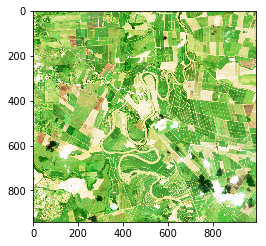

In [390]:
plt.figure(figsize=(4,4))
plt.imshow(image_histogram_equalization(data.reflectance.sel(band=['B02', 'B03', 'B04']).isel(date=1).values))

# NDVI

Each pixel in our dataset is made up of 10 values (Sentinel 2 bands ['B02', 'B03', 'B04', 'B05', 'B06', 'B07', 'B08', 'B8A', 'B11', 'B12']). These values represent how bright the surface was in a different band (see here for a full description: https://en.wikipedia.org/wiki/Sentinel-2). Usually, we aren't interested in the absolute brightness and so we prefer to use the ratios of brightness between bands.

For example, we can calculate a reflectance (R) ratio called the 'Normalised Differential Vegetation Index':

$R_{NDVI}=(R_{IR}-R_{Red})/(R_{IR}+R_{Red})$

This ignores the overall brightness and just indicates the relative difference in reflectance between the 2 wavebands.

The NDVI ratio for SENTINEL-2 uses the bands 4 and 8. The code below calculates the NDVI:

In [144]:
def NDVI(reflectance_array):
    """ takes an xarray.DataArray object with the a 'band' coordinate dimension
    and returns an xarray.DataArray of NDVI values"""
    # be careful when calculating indices using the integer arrays
    # usually representing raster data. Explicitly convert to floats
    # for division.
    r = np.array(reflectance_array.sel(band='B04'),dtype='float')
    ir = np.array(reflectance_array.sel(band='B08'),dtype='float')
    return xarray.DataArray((ir-r)/(ir+r))

In [145]:
# make a list of dates
dates = [str(x.values)[:10] for x in s2_data.date]
print('Image dates: '+', '.join(dates))

Image dates: 2016-12-18, 2017-02-16, 2017-04-27, 2017-06-06, 2017-07-16, 2017-12-18, 2018-01-07, 2018-02-26, 2018-04-07, 2018-06-21, 2018-07-01, 2018-07-11, 2018-07-16, 2018-07-26, 2018-08-20, 2018-09-19, 2018-09-29, 2018-10-04, 2018-10-14, 2018-12-03, 2018-12-18, 2018-12-28, 2019-01-02, 2019-01-12, 2019-01-17, 2019-01-22


# Visualizing different bands

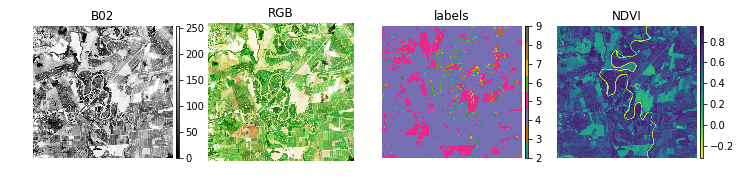

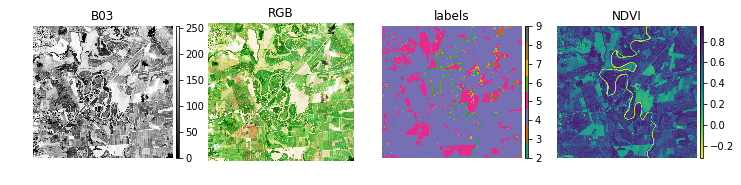

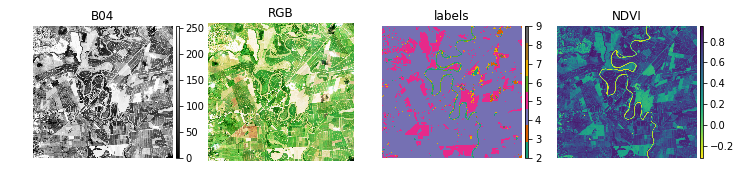

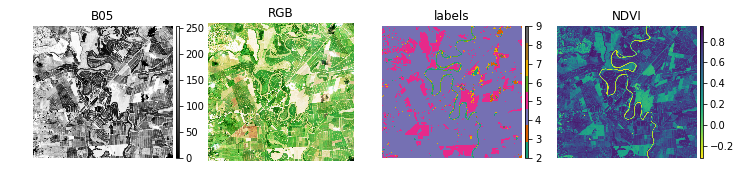

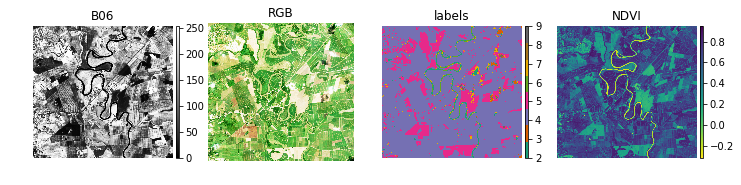

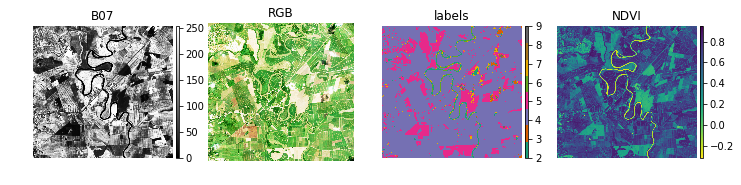

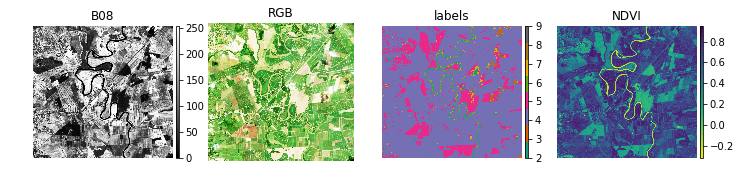

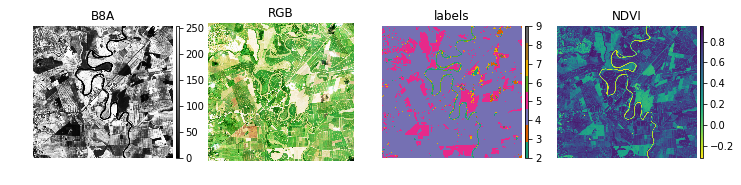

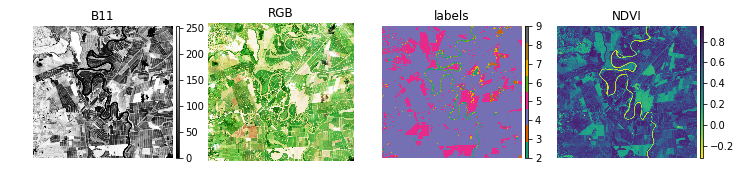

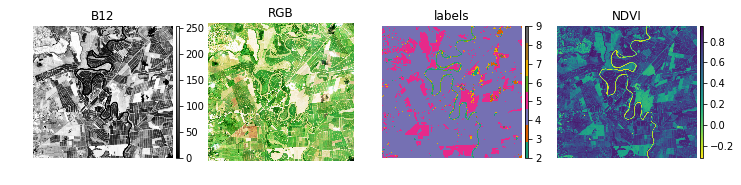

In [392]:
date = 21

for i, band in enumerate(data.band.values):
    fig = plt.figure(figsize=(12,10))
    
    ax1 = fig.add_subplot(141)
    im1 = ax1.imshow(image_histogram_equalization(data.reflectance.sel(band=str(band)).isel(date=date).values/10000), 
                     cmap='gray', interpolation='nearest', origin='lower')
    plt.title(str(band))
    divider1 = make_axes_locatable(ax1)
    cax1 = divider1.append_axes("right", size="2%", pad=0.05)
    plt.colorbar(im1, cax=cax1)
    ax1.set_axis_off()
    
    ax2 = fig.add_subplot(142)
    ax2.imshow(image_histogram_equalization(data.reflectance.sel(band=['B02', 'B03', 'B04']).isel(date=date).values),
               interpolation='nearest', origin='lower')
    plt.title('RGB')
    ax2.set_axis_off()
    
    ax3 = fig.add_subplot(143)
    im3 = ax3.imshow(data.SCL.isel(date=date).values, cmap='Dark2', interpolation='nearest', origin='lower')
    plt.title('labels')
    divider3 = make_axes_locatable(ax3)
    cax3 = divider3.append_axes("right", size="2%", pad=0.05)
    plt.colorbar(im3, cax=cax3)
    ax3.set_axis_off()
    
    ax4 = fig.add_subplot(144)
    im4 = ax4.imshow(NDVI(s2_data.reflectance.isel(date=date)), cmap='viridis_r', interpolation='nearest', origin='lower')
    plt.title('NDVI')
    divider4 = make_axes_locatable(ax4)
    cax4 = divider4.append_axes("right", size="2%", pad=0.05)
    plt.colorbar(im4, cax=cax4)
    ax4.set_axis_off()


# Visualizing different dates

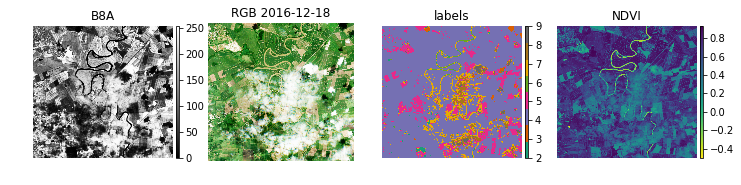

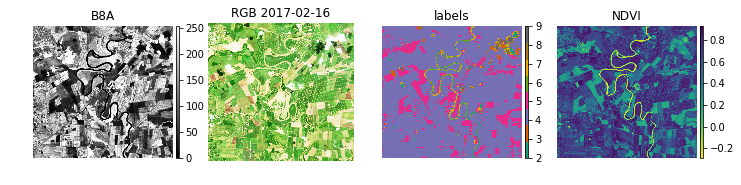

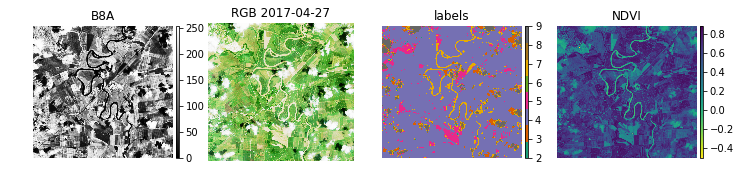

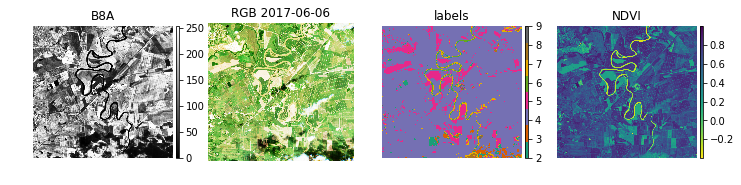

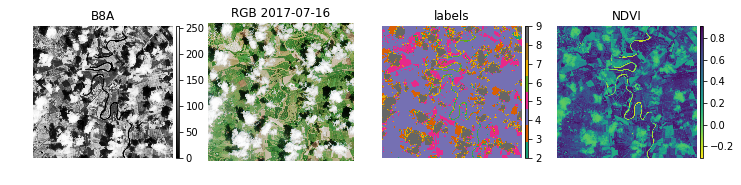

...

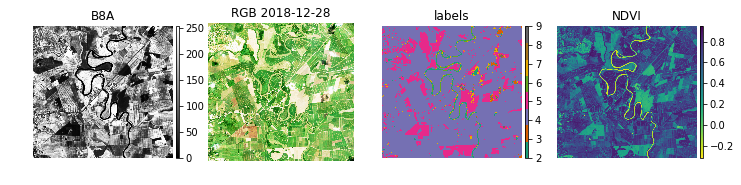

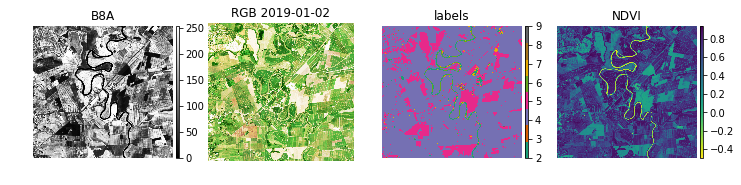

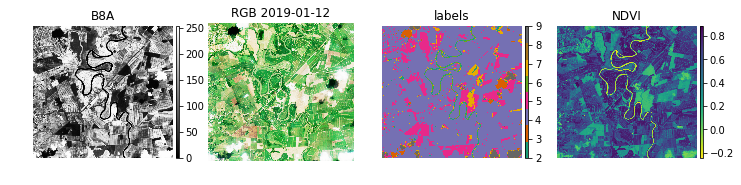

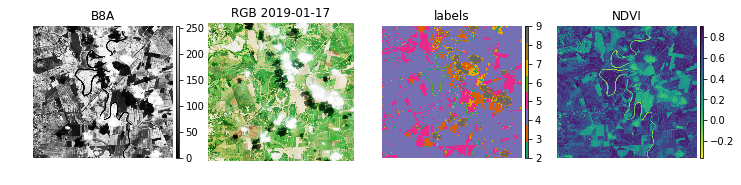

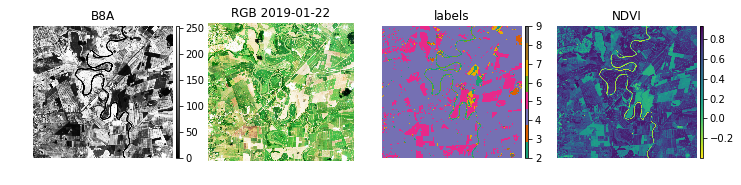

In [393]:
band = 'B8A'

for i, date in enumerate(dates):
    fig = plt.figure(figsize=(12,10))
    
    ax1 = fig.add_subplot(141)
    im1 = ax1.imshow(image_histogram_equalization(data.reflectance.sel(band=str(band)).isel(date=i).values/10000), 
                     cmap='gray', interpolation='nearest', origin='lower')
    plt.title(str(band))
    divider1 = make_axes_locatable(ax1)
    cax1 = divider1.append_axes("right", size="2%", pad=0.05)
    plt.colorbar(im1, cax=cax1)
    ax1.set_axis_off()
    
    ax2 = fig.add_subplot(142)
    ax2.imshow(image_histogram_equalization(data.reflectance.sel(band=['B02', 'B03', 'B04']).isel(date=i).values),
               interpolation='nearest', origin='lower')
    plt.title('RGB '+ str(date))
    ax2.set_axis_off()
    
    ax3 = fig.add_subplot(143)
    im3 = ax3.imshow(data.SCL.isel(date=i).values, cmap='Dark2', interpolation='nearest', origin='lower')
    plt.title('labels')
    divider3 = make_axes_locatable(ax3)
    cax3 = divider3.append_axes("right", size="2%", pad=0.05)
    plt.colorbar(im3, cax=cax3)
    ax3.set_axis_off()
    
    ax4 = fig.add_subplot(144)
    im4 = ax4.imshow(NDVI(s2_data.reflectance.isel(date=i)),cmap='viridis_r', interpolation='nearest', origin='lower')
    plt.title('NDVI')
    divider4 = make_axes_locatable(ax4)
    cax4 = divider4.append_axes("right", size="2%", pad=0.05)
    plt.colorbar(im4, cax=cax4)
    ax4.set_axis_off()


# NDVI time series

In [189]:
ndvis = np.zeros((26, 940, 994))

for i, date in enumerate(dates):
    temp = NDVI(s2_data.reflectance.isel(date=i))
    ndvis[i] = temp

In [271]:
ndvis.min(), ndvis.max()

(-0.648881239242685, 0.99958071278826)

In [276]:
ndvis_thresh = ndvis.copy()
ndvis_thresh[ndvis_thresh < 0.5] = np.nan

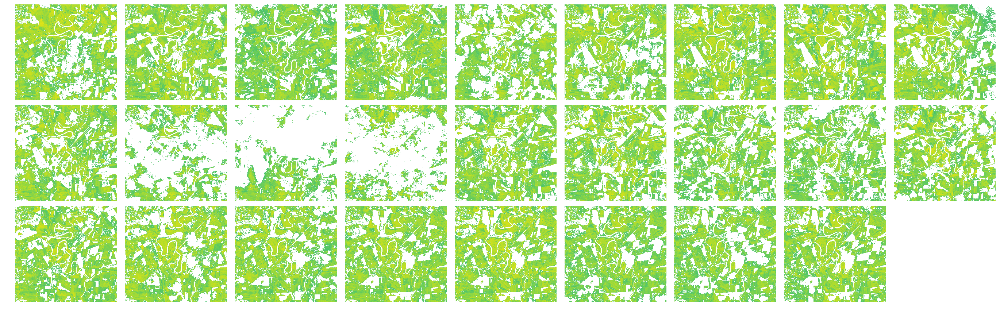

In [277]:
plots(ndvis_thresh, axis=False, rows=3, maxplots=26, versp=0.05, horsp=0.04, vmin=-0.7, vmax=1, colorb=False)

# RGBs time series

In [326]:
rgbs = []

for i in range(len(data.date)):
    rgbs.append(image_histogram_equalization(data.reflectance.sel(band=['B02', 'B03', 'B04']).isel(date=i).values))
    
rgbs = np.array(rgbs)

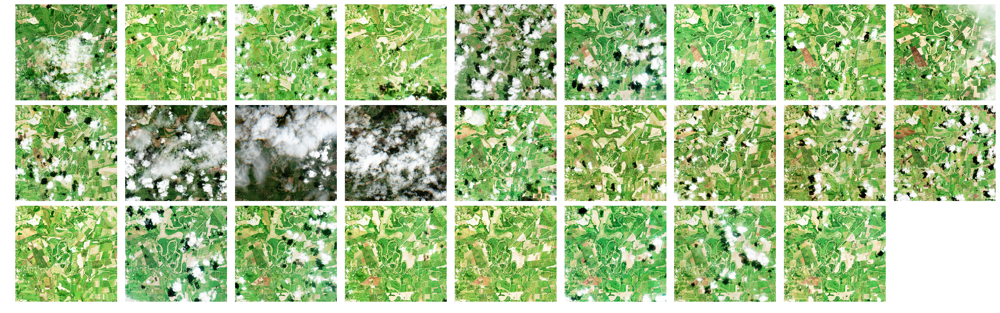

In [336]:
plots(rgbs[0], rgbs[1], rgbs[2], rgbs[3], rgbs[4], rgbs[5], rgbs[6], rgbs[7], rgbs[8], rgbs[9], rgbs[10], rgbs[11],
      rgbs[12], rgbs[13], rgbs[14], rgbs[15], rgbs[16], rgbs[17], rgbs[18], rgbs[19], rgbs[20], rgbs[21], rgbs[22], rgbs[23],
      rgbs[24], rgbs[25], rows=3, axis=False, versp=0.05, horsp=0.04, colorb=False)

# Sugarcane spectral signature

It's known that most of the crops in this region are Sugarcane. Since we don't have any labels, we're limited in terms of what ML we could apply. One initial idea could be to explore the spectral signature of the Sugercane crop. 

In [365]:
sugca_ref = np.array([300, 1000, 600, 500, 3500, 4000, 4250, 4500, 1500, 750])

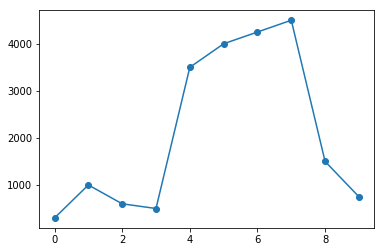

In [366]:
plot(sugca_ref, 'o-')

Picking 4 locations manually:

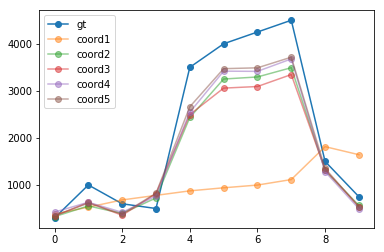

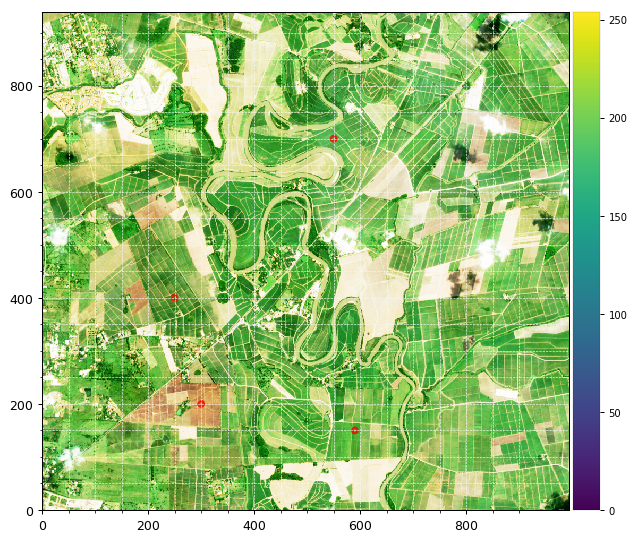

In [389]:
date = 21 

plot(sugca_ref, 'o-', label='gt')

# Y, X
coords = ((200, 300), (400, 250), (150, 590), (700, 550), (500, 380))
for i, coord in enumerate(coords):
    plot(data.reflectance.isel(date=date).values[coord], 'o-', label='coord'+str(i+1), alpha=0.5)
legend()

im = image_histogram_equalization(data.reflectance.sel(band=['B02', 'B03', 'B04']).isel(date=date).values)
plots(im, grid=True, gridspacing=50, gridalpha=1, spsize=8,
      circle=((coord1[1], coord1[0]), (coord2[1], coord2[0]), (coord3[1], coord3[0]), 
              (coord4[1], coord4[0])), circlelabel=False, circlerad=5, circlecolor='red')

Picking 10 random locations:

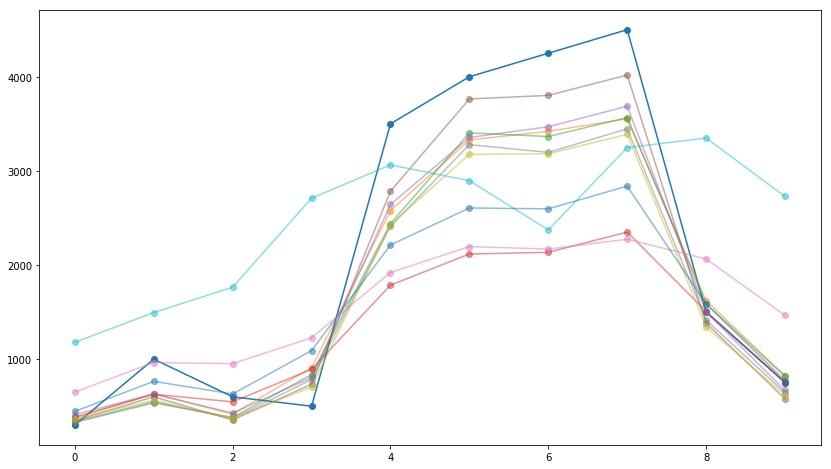

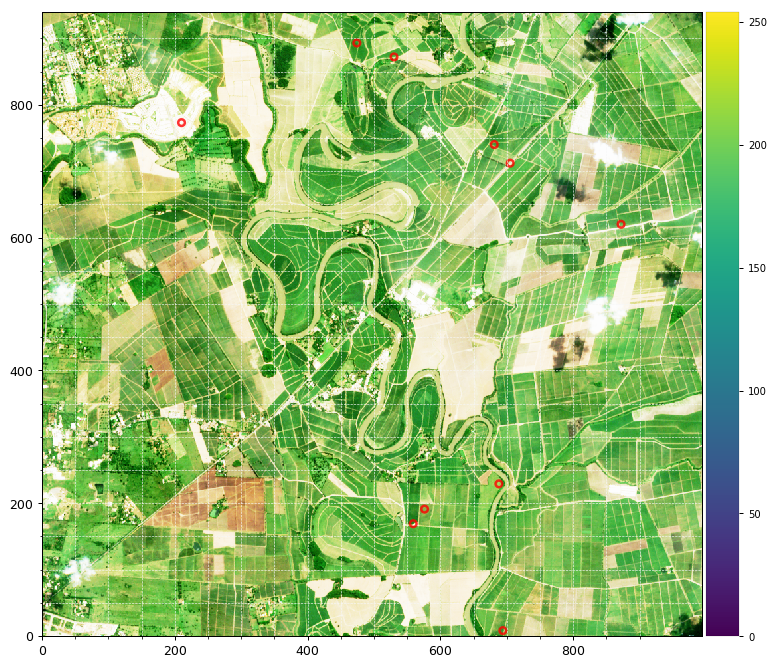

In [304]:
date = 21 

figure(figsize=(14, 8))
plot(sugca_ref, 'o-', label='gt')

# Y, X 
coords = []
coords_xy = []
for i in range(10):
    y = np.random.randint(0, 940)
    x = np.random.randint(0, 994)
    coords.append((y, x))
    coords_xy.append((x, y))
    
for i, coord in enumerate(coords):
    plot(data.reflectance.isel(date=date).values[coord], 'o-', label='coord'+str(i+1), alpha=0.5)
# legend()

im = image_histogram_equalization(data.reflectance.sel(band=['B02', 'B03', 'B04']).isel(date=date).values)
plots(im, grid=True, gridspacing=50, gridalpha=1, spsize=10, 
      circle=coords_xy, circlelabel=False, circlerad=5, circlecolor='red')

A basic approach would be to measure the cross-correlation between a given pixel and the Sugarcane signature:

[[0.30035542]]


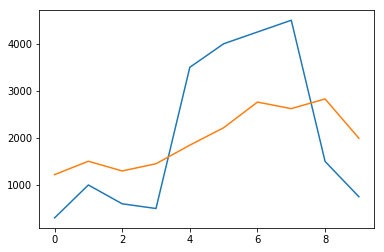

[[0.01090742]]


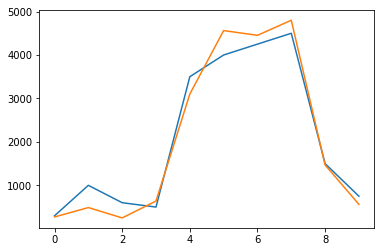

[[0.01805398]]


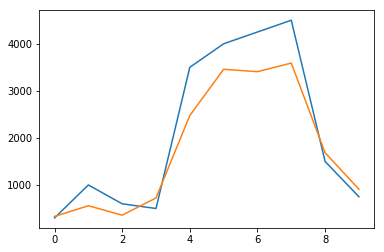

[[0.32568787]]


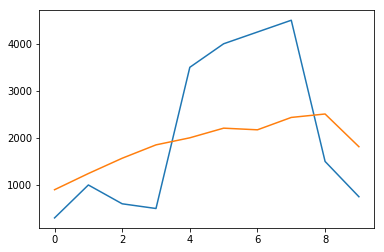

[[0.12985998]]


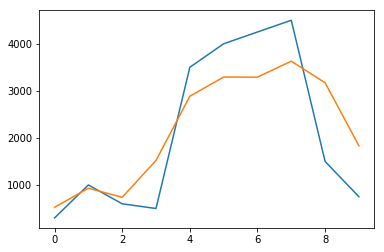

[[0.02151665]]


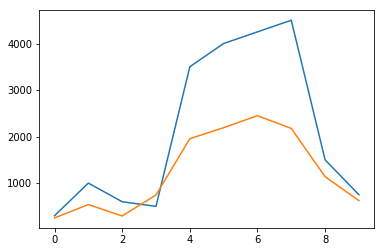

[[0.00881566]]


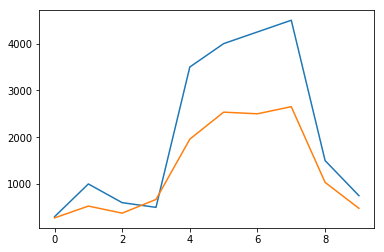

[[0.01449169]]


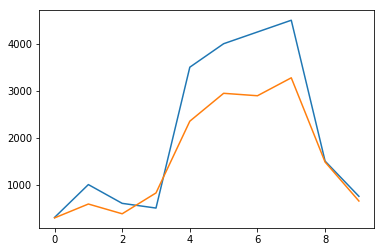

[[0.01490827]]


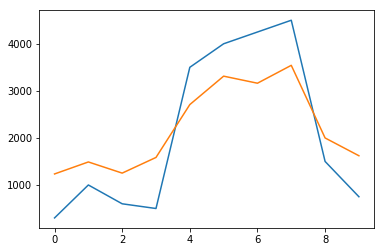

[[0.01802447]]


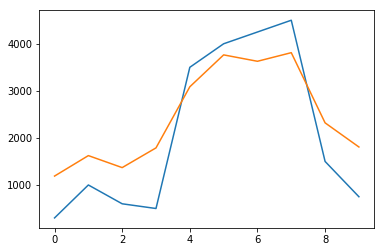

In [383]:
from sklearn.metrics import pairwise_distances

for i in range(10):
    figure()
    print(pairwise_distances(sugca_ref.reshape(1, -1), data.reflectance.isel(date=0).values[coords[i]].reshape(1, -1), 
                             metric='correlation'))
#                              metric='euclidean'))
#                              metric='l1'))
#                              metric='cosine'))

    plot(sugca_ref)
    plot(data.reflectance.isel(date=0).values[coords[i]])
    show()